# Self-Driving Car Engineer Nanodegree

## Computer Vision

## Project: Advanced Lane Finding

In this notebook, a template is provided for you to implement your functionality in stages which is required to successfully complete this project. If additional code is required that cannot be included in the notebook, be sure that the Python code is successfully imported and included in your submission, if necessary. Sections that begin with **'Implementation'** in the header indicate where you should begin your implementation for your project. Note that some sections of implementation are optional, and will be marked with **'Optional'** in the header.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut. In addition, Markdown cells can be edited by typically double-clicking the cell to enter edit mode.

## 0. Import Libraries

In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as pimg
import glob
import cv2
from datetime import timedelta
from time import time
from random import random
import os.path
%matplotlib inline

# Everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML


## 1. Helpers, Lane Tracking Class and Globals

In [2]:
########################################################
# Helper function to plot images side-by-side with title
########################################################
def plot_gallery(images, titles, h, w, n_row=5, n_col=4):
    """Helper function to plot a gallery of portraits"""
    # plt.figure(figsize=(2.0 * n_col, 2.4 * n_row))
    plt.figure(figsize=(3.0 * n_col, 3.6 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.25)
    llen = 11
    for i in range(min(n_row * n_col, len(images))):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i], cmap=plt.cm.gray)
        title_i = titles[i]
        if len(title_i) >= llen:
            title_i = titles[i][llen:]
        plt.title(title_i, size=8)
        plt.xticks(())
        plt.yticks(())

        
#####################################################################
# class to keep track the characteristics of each Lane line detection
# N.B.
#    First Implementation, use this class just as global data struct
#    Future TODO: refactor code towards OOP, add methods and classes
#
#    This class is vital to reject bad sample points and fitted line
#
#    Initial Version: have ZERO class parameters!
#    Set it with short memory of 10 last entries.
#
#####################################################################

class Laneline():
    def __init__(self):
        # cache size, tunable:
        self.n = 5
        
        # xbase shift limit (unit: pixel) for rejection
        self.xbase_offlimit = 100 # 300

        # quadratic coefficient c2 (x-axis intercept) offlimit to reject!
        # c2 is x-axis intercept of fitted curve line, set as ~5% of Xmax
        self.c2fit_offlimit = 100
        
        # x base values of the last n fits of the line
        # append use: list_name.append(value)
        # to pop use: list_name.pop(0)
        self.all_xbases = []
        
        #average x base of the fitted line over the last n iterations
        # self.mean_xbase = int(np.mean(self.all_xbases))
        self.mean_xbase = None

        # quadratic polynomial coefficients of the last n lines fits
        # e.g. [ array([ 0.00275482,  0.03030303,  0.33333333]),
        #        array([ 0.00275532,  0.03030633,  0.33333465]) ]
        self.all_fits = []
        
        # polynomial coefficient averaged over the last n iterations
        # self.mean_fit = np.mean(self.all_fits, axis=0)
        # e.g. array([ 0.00275482,  0.03030303,  0.33333333])
        self.mean_fit = None

        # X/Y coordinates of last found points from sliding windows
        self.lastx = None
        self.lasty = None

        
        ###################################
        #     Undefined -or- obsoleted    #
        #   Some of these can be used to  #
        #  enhance tracking in the future #
        ###################################
        
        # was the line detected in the last iteration?
        # If not, then rejected it and use prior cache
        # N.B. before n good ones cached will not tell
        # self.detected = False

        # x top (where y=0) values of last n fit line
        # x top is calculated post polynomial fit y=0
        # it is good scalar to tell if fit an outlier
        # Initially not used, add support when needed
        # self.all_xtops = []
        
        #average x top of the fitted line over the last n iterations
        # self.mean_xtop = int(np.mean(self.mean_xtop))
        # Initially not used, add support when needed
        # self.mean_xtop = None
        
        # This is obsoleted, as it is the last one in list: all_fits
        # polynomial coefficients for the most recent fit
        # self.current_fit = [np.array([False])]

        # obsolete: last_xbase = all_xbases[-1]
        # self.last_xbase = None
        
        # radius of curvature of the fitted line in some units
        # self.radius_of_curvature = None
        
        # distance in centimeters from vehicle center to lane center
        # self.line_base_pos = None
        
        # difference in fit coefficients between last and new fits
        # self.diffs = np.array([0,0,0], dtype='float')
        
        # x values for detected line pixels
        # self.allx = None
        
        # y values for detected line pixels
        # self.ally = None
        
        
    # class method to tell if new_xbase is valid one or not
    # to reject noise, it also updates cache if appropriate
    def xbase_valid(self, new_xbase):
        if len(self.all_xbases) < self.n:
            # just add, if not enough history
            self.all_xbases.append(new_xbase)
            self.mean_xbase = int(np.mean(self.all_xbases))
            return True
        else:
            # when this class instance has cached enough hist. records
            # if abs(new_xbase - self.mean_xbase) > self.xbase_offlimit:
            if abs(new_xbase - self.all_xbases[-1]) > self.xbase_offlimit:
                # when new_xbase is offlimit, user should call:
                # xbase_get() to get last good xbase from cache
                return False
            else:
                # update cache and mean
                self.all_xbases.pop(0)
                self.all_xbases.append(new_xbase)
                self.mean_xbase = int(np.mean(self.all_xbases))
                return True

    # class method for user to get last good xbase in cache
    def xbase_get(self):
        if len(self.all_xbases):
            return self.all_xbases[-1]
        

    # class method to tell if a new fit is valid one or not
    # to reject noise, it also updates cache if appropriate
    # N.B. Input: new_fit is np.array return of np.polyfit()
    def fit_valid(self, new_fit):
        if len(self.all_fits) < self.n:
            # just add, if not enough history
            self.all_fits.append(new_fit)
            self.mean_fit = np.mean(self.all_fits, axis=0)
            return True
        else:
            # when this class instance has cached enough fits history
            if ( abs(new_fit[2] - self.mean_fit[2]) > self.c2fit_offlimit ):
                # when new_fit X-intercept is offlimit, user should call:
                # fit_get() to get last good fit (coeeficient) from cache
                return False
            else:
                # update cache and mean
                self.all_fits.pop(0)
                self.all_fits.append(new_fit)
                self.mean_fit = np.mean(self.all_fits, axis=0)
                return True

    # class method for user to get last good fit coefficients
    def fit_get(self):
        if len(self.all_fits):
            return self.mean_fit
            #return self.all_fits[-1]


            
            
#################################################################
# Program globals (most of calibration / testing images specific)
#################################################################


# Camera(Video) is set with the same size for all Images/Frames
# N.B. there are a few images misformed, e.g. calibration7 & 15
# We should normalize image size whenever necessary
w = 1280
h = 720
imsize = (w, h)

# Output file base path (relative to this IPython notebook file)
outputpath = 'output_images/'

#######################################################
# Calibration section (most not used in video pipeline)
#######################################################

# N.B. Not all are used in image pipeline here, most are used
# to generate results (camera matrix) to be used in pipeline!

# First
# Prepare static object points of whole chessboard, like
# (0,0,0), (1,0,0), ...,(8,5,0) left-2-right, top-2-down
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# N.B. not all objectpoints from every calibration image
# will be picked for calibration, depending upon pattern
# extracted by cv2.findChessboardCorners, some calibrate
# image will yield less recognized corners than others..

# My list of empirical patternSize to calibrate camera using all
# provided calibration images.  There is NO single pattern works
# for all 20 images, E.g. we have following special patternSize:

# N.B. image    pattern  method to pick correct dest. obj points
# calibration1: (9, 5)   - Upper 5 rows,    if mean(Y) < ( 720/2)
# calibration4: (5, 6)   - Left  5 columns, if mean(X) < (1280/2)
# calibration5: (7, 6)   - right 7 columns, if mean(X) > (1280/2)
# other images: (9, 6)   - pick all

# So try vectors: (9, 6), (9, 5), (7, 6), (5, 6)
# In the implementation method below I iterate through different
# patternSize, and populate correct objectpoints automatically!

patternSz = [(9, 6), (9, 5), (7, 6), (5, 6)]


# List of to be calibrated images
images = glob.glob('camera_cal/calibration*.jpg')
imgNum = len(images)

# List of buffers to store and display calibrated images
# There are imgNum (20) calibrated images
Image = np.zeros((imgNum, h, w, 3), np.uint8)

# Global Flags
CamCalibrated = False

# Camera matrix and distortion coefficients are produced later


#################################################################
#  Perspective Tranform section (most not used in video pipeline)
#################################################################

# List of test images in '/test_images'
timages = glob.glob('test_images/*.jpg')
timgNum = len(timages)

# Placeholder for undistorted test images
uImage = np.zeros((timgNum, h, w, 3), np.uint8)

# Placeholder for Perspective Transformed (birdeye) test images
tImage = np.zeros((timgNum, h, w, 3), np.uint8)


#############################################################################
#  Color space and Gradient/Sobel Filter section (not used in video pipeline)
#############################################################################

# Placeholder for Filtered (S-channel and Sobel-x combined) test images
fImage = np.zeros((timgNum, h, w), np.uint8)




##############################
#  Lane Lines Finding section
##############################

# Define y-value where we want radius of curvature
# Choose the maximum y-value, corresponding to the bottom of the image
y_eval = h   # h = 720

# Definition for polynomial fitted line points
# fitted line points Y values
yvals = np.arange(h)

# fitted line X values for test image
tl_fitx = np.zeros((timgNum, h))
tr_fitx = np.zeros((timgNum, h))

# Lane line Curvature Radius (m) of test images
rad = np.zeros((timgNum))

# Lane line Center Departure (cm) of test images
dev = np.zeros((timgNum))


# Define conversions in x and y from pixels space to meters
# Warning: These numbers aren't calibrated according to our
#          region selection for perspective transformations
ym_per_pix = 30/720      # meters per pixel in y dimension
xm_per_pix = 3.7/700     # meters per pixel in x dimension


# Placeholder for final Warped back (onto undistorted vs. very original) test images
wImage = np.zeros((timgNum, h, w), np.uint8)


## 2. Calibrate Camera

In [3]:
# Return (retval, mtx, dist)
def cameraCalibrate(imagelist):
    
    global CamCalibrated
    if CamCalibrated == True:
        return (0,0,0)
    
    # Arrays to store object points and image points from all calibration images
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane
    
    # Step through the list and search for chessboard corners
    for idx, fname in enumerate(imagelist):
        img = cv2.imread(fname)
        # Normalize image size. N.B. calibration7/15 shape = (721, 1281, 3)
        img = img[0:h,0:w,:]
        
        # output image with ChessboardCorners Drew 
        outfile = outputpath + fname.split('/')[1].split('.')[0] + '-corners.jpg'
    
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        for pattern in patternSz:
            # Find the chessboard corners
            ret, corners = cv2.findChessboardCorners(gray, pattern, None)

            # If found, add object points, image points
            if ret == True:
                # Calc geometry center of found corners
                # Use them to identify object points in
                # closeup shots (i.e. not all included)
                extracted = corners.reshape(-1, 2)
                geoCenter = np.mean(extracted, axis=0)
            
                # in case (9, 5) select correct rows
                if pattern == patternSz[1]:
                    if geoCenter[1] < h/2:
                        # top 5 rows of objp, use list comprehension
                        rows= [i for i in range(objp.shape[0] - 9)]
                    else:
                        # bottom 5 rows objp
                        rows= [i for i in range(9, objp.shape[0])]
                    objpoints.append(objp[rows,:])
                    imgpoints.append(corners)
                
                # in case (7, 6) select correct columns
                elif pattern == patternSz[2]:
                    if geoCenter[0] < w/2:
                        # left 7 columns of objp, use list comprehension
                        rows= [i for i in range(objp.shape[0]) if (i%9) < 7]
                    else:
                        # right 7 columns objp, to pick correct rows from 1D of 6*9
                        rows= [i for i in range(objp.shape[0]) if (i%9) > 1]
                    objpoints.append(objp[rows,:])
                    imgpoints.append(corners)

                # in case (5, 6) select correct columns
                elif pattern == patternSz[3]:
                    if geoCenter[0] < w/2:
                        # left 5 columns of objp, use list comprehension
                        rows= [i for i in range(objp.shape[0]) if (i%9) < 5]
                    else:
                        # right 5 columns objp, to pick correct rows from 1D of 6*9
                        rows= [i for i in range(objp.shape[0]) if (i%9) > 3]
                    objpoints.append(objp[rows,:])
                    imgpoints.append(corners)

                # in case (9, 6) select all objp points as default
                else:
                    objpoints.append(objp)
                    imgpoints.append(corners)

                # Draw and display the corners
                cv2.drawChessboardCorners(img, pattern, corners, ret)
                Image[idx] = img
                cv2.imwrite(outfile, cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                break

    retval, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, imsize,None,None)
    # We won't use rvecs, tvecs in this project
    # calibrateCamera returns the root mean square (RMS) re-projection error,
    # usually it should be between 0.1 and 1.0 pixels in a good calibration.
    # An RMS error of 1.0 means on average each of these projected points is
    # 1.0 px away from its actual position.

    # Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
    dist_pickle = {}
    dist_pickle["mtx"] = mtx
    dist_pickle["dist"] = dist
    pickle.dump( dist_pickle, open( "camera_cal/distpickle.p", "wb" ) )
    
    CamCalibrated = True
    return (retval, mtx, dist)

### 2.1 Generate Global Camera Matrix (`mtx`) and Distortion Coefficients (`dist`) to be used in Pipeline

In [4]:
# This cell generates global camera matrix and distortion coefficients that are used in image pipeline

# Calibrate Camera: 
#   Generate -OR- Load Global Camera Matrix, Distortion Coefficients here!

rms, mtx, dist = cameraCalibrate(images)
print(rms)

if (rms, mtx, dist) == (0,0,0):
    # then load camera and distrortion matrix from pre-pickled file: `camera_cal/distpickle.p`
    dist_file = 'camera_cal/distpickle.p'
    with open(dist_file, mode='rb') as f:
        dist_pickle = pickle.load(f)

    mtx  = dist_pickle['mtx']
    dist = dist_pickle['dist']

1.1966640108777111


### 2.2 Plot Calibration Images with ChessboardCorners Drew (saved as `output_images/*-corners.jpg`)

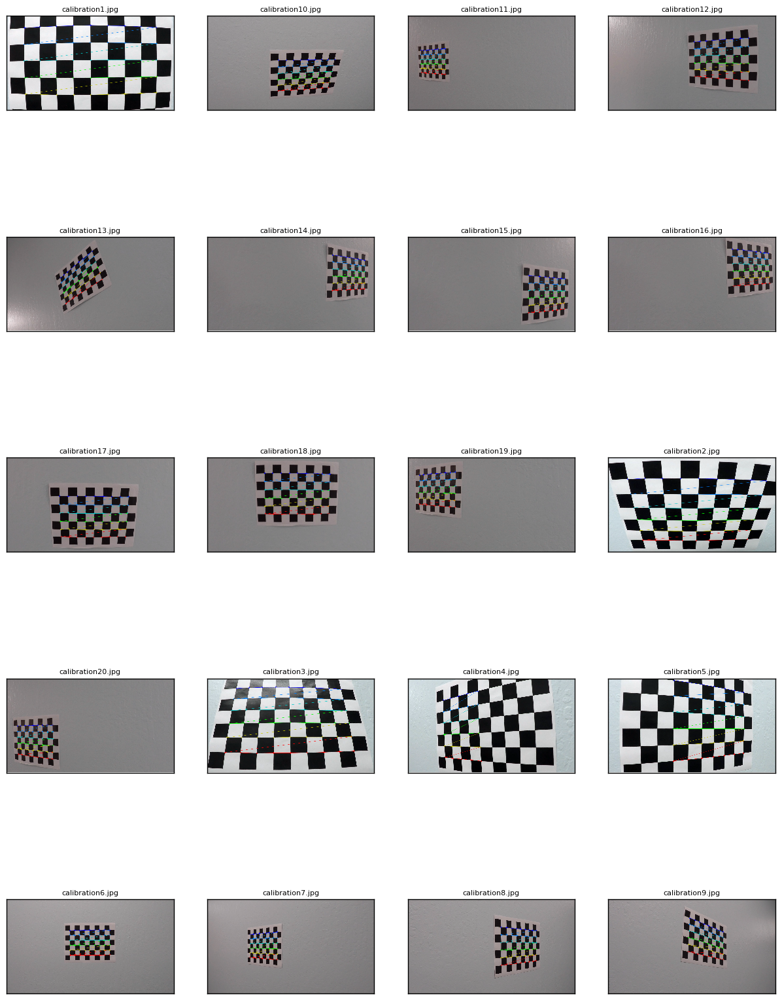

In [5]:
plot_gallery(Image, images, 720, 1280, 5, 4)

### 2.3 Plot Undistorted Calibration Images (saved as `output_images/*-undist.jpg`)

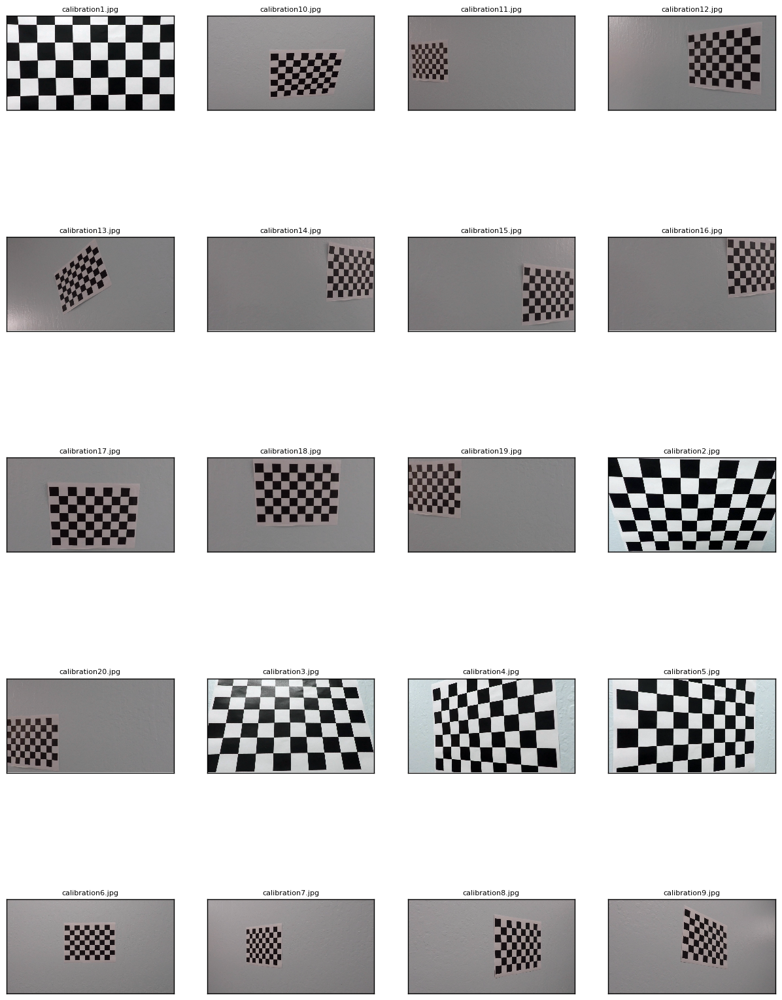

In [6]:
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    img = img[0:h,0:w,:]

    # output undistorted image 
    outfile = outputpath + fname.split('/')[1].split('.')[0] + '-undist.jpg'
    
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    Image[idx] = dst
    cv2.imwrite(outfile, cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))

plot_gallery(Image, images, 720, 1280, 5, 4)


## 3. Perspective transform (tuning with example `Bird-Eye views` on `test images`)
### 3.1 Generate Global Perspective Transform Matrix (`M`) and Inverse Matrix (`Minv`) to be used in Pipeline

In [7]:
# This cell generates global perspective tranform (and Inverse) matrix that are used in image pipeline

# It's not part of direct image pipeline, rather than a parameter tunning (M & Minv) and demonstration

# consider challenge (forest) video, it is suggested that we use parameterized field depth vs. static
# In other words, use much shorter road distance (10-20m vs. 30m). Lane width may still be 3.7m

## TODO: Set following values - less hard code please 

src = np.float32([[530, 480], [ 770, 480], [50, 720], [1250, 720]])
dst = np.float32([[ 50,   0], [1250,   0], [50, 720], [1250, 720]])

M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)
# N.B.  So we have acquired perspective transform matrix M, but it is rather static
#       we don't have to generate it from each frame in video pipeline, just use it
# CONS: Limitation comes from this static setting (src/dst points selection): it is
#       expected that when road is narrower, windier or hillier, It may fail!
# TODO: Find better/adaptive perspective transformation scheme for challenge videos


### 3.2 Plot `Bird-Eye view` images (saved as `output_images/*-birdeye.jpg`)

### Visual validation of an effective perspective transform 

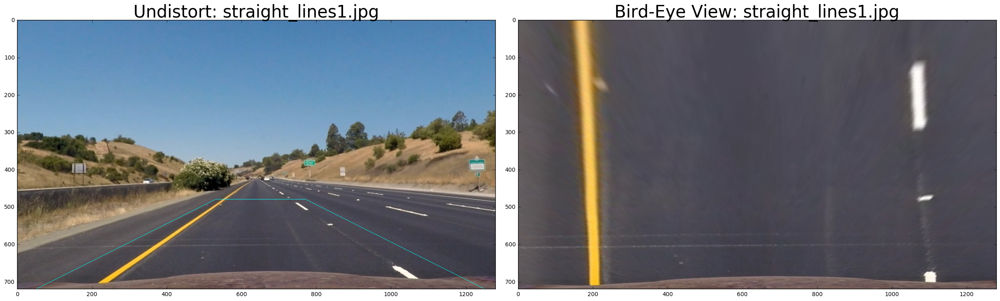

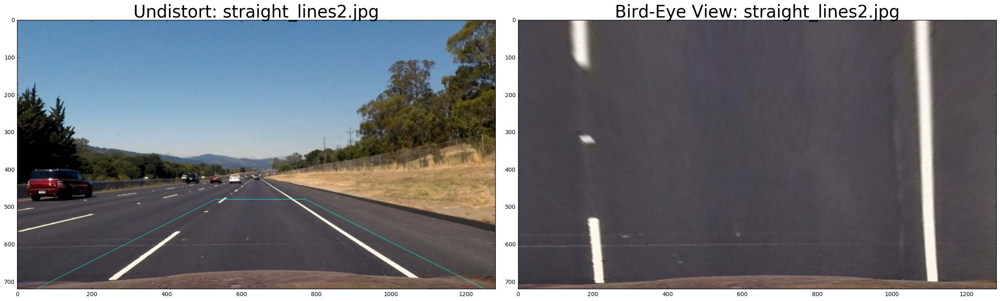

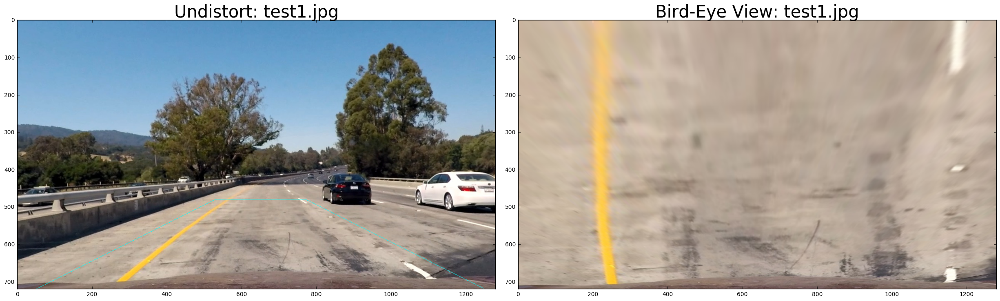

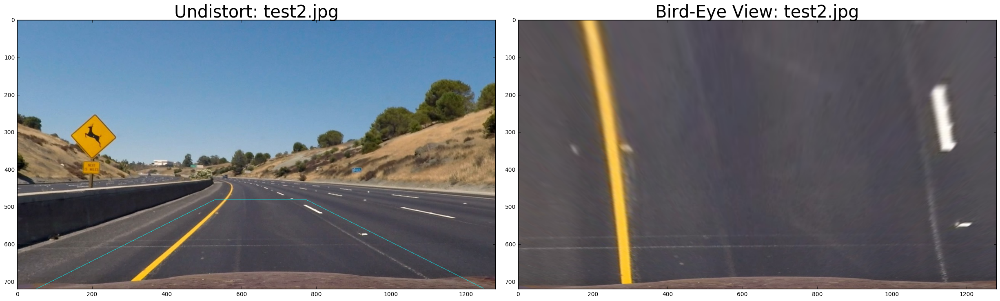

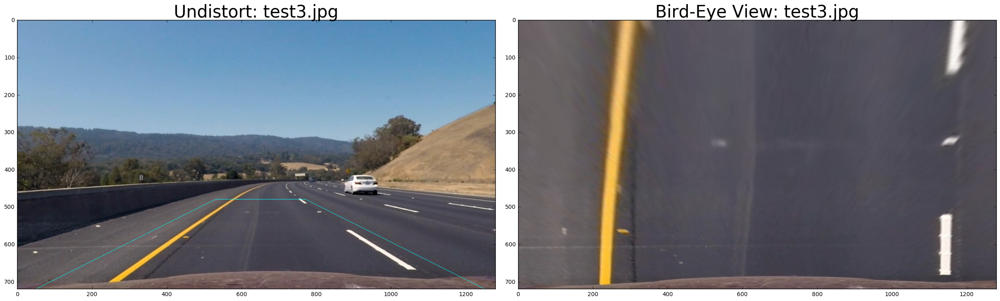

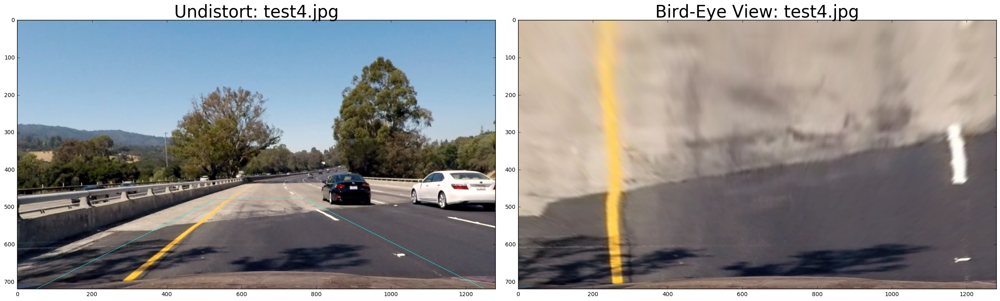

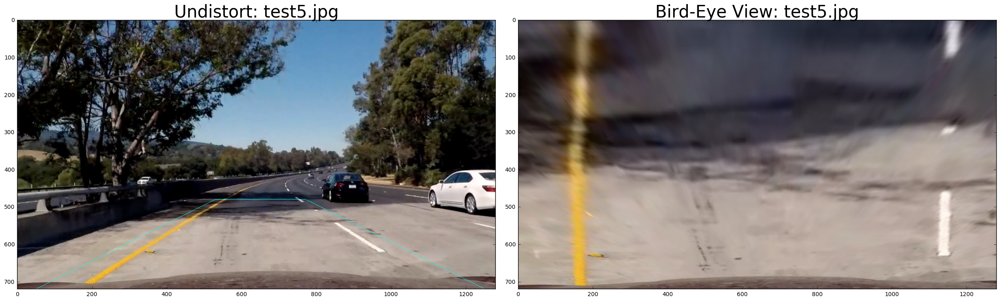

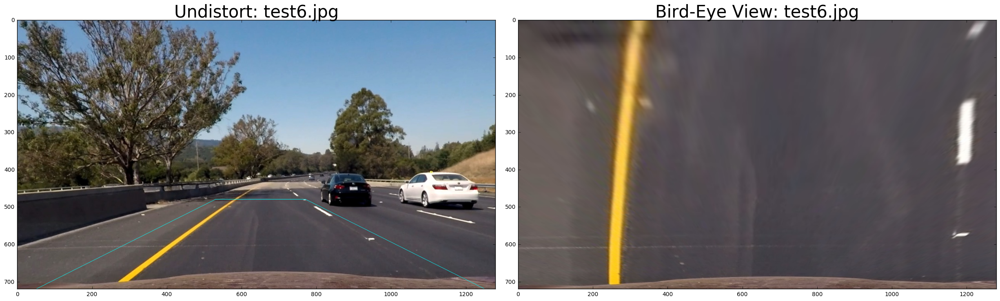

In [8]:

#######################################################################################
# Steps below show undistorted and perspective transformed birdeye views on test images
#
# N.B.
#   And validated (visually) correct parameter setting (src & dst points) for transform
#######################################################################################

# Step through the test images with birdeye images generated, plot them side-by-side
# to assess the `correct` setting of our PerspectiveTransform (given selected points).
for idx, fname in enumerate(timages):

    # output birdeye image
    outfile = outputpath + fname.split('/')[1].split('.')[0] + '-birdeye.jpg'
    
    img = cv2.imread(fname)
    # this cv2.resize is kept here to deal with
    # `solidWhiteRight.jpg` and `solidYellowLeft.jpg`
    if img.shape[:2] != (720, 1280):
        img = cv2.resize(img, (1280, 720), interpolation = cv2.INTER_CUBIC)
        
    # undistort image from prior calibrations:
    img = cv2.undistort(img, mtx, dist, None, mtx)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    uImage[idx] = img

    birdeye = cv2.warpPerspective(img, M, imsize, flags=cv2.INTER_LINEAR)
    tImage[idx] = birdeye
    cv2.imwrite(outfile, cv2.cvtColor(birdeye, cv2.COLOR_BGR2RGB))
    
    # Mid-x = 650 vs. 640, use 650 as lane center
    # Draw Region of Selection points for PerspectiveTransform on image
    # N.B. This is just for demonstration of Region of Selection. These
    #      lines should NOT be drawn on images to polyfit() in Pipeline 
    ## pts = np.array([[530,480],[770,480],[1250,720],[50,720]], np.int32)
    ## TODO

    pts = np.array([[530,480],[770,480],[1250,720],[50,720]], np.int32)
    pts = pts.reshape((-1,1,2))
    cv2.polylines(img,[pts],True,(0,255,255),1)

    ##############################################################################
    # Drew (in Left column images) Region of Selection `src` for birdeye transform
    ##############################################################################

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Undistort: ' + fname[12:], fontsize=30)
    ax2.imshow(birdeye)
    ax2.set_title('Bird-Eye View: ' + fname[12:], fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


#### 3.2.1 Now that we know our `static` perspective transformation works ok, via visual check of bird's eye views on test images above. 
+ Coming next, use birdeye view images for gradient and color space mask processing, for lane lines extraction.

## 4. Color & Gradient Transform (produce binary image to `fit` using `Bird-Eye test image`)
### 4.1 S channel (robust and reliable lane line extraction under different color and contrast conditions) threshing

In [9]:
# Define a function that thresholds the S-channel (from HLS color scheme)
#
# Input:    img - bird-eye view image
#        thresh - S-channel threshold
#
def s_select(img, thresh=(0, 255)):
    # Convert RGB to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s = hls[:,:,2]
    # Apply a threshold to the S channel
    s_binary = np.zeros_like(s)
    s_binary[(s > thresh[0]) & (s < thresh[1])] = 1
    # Return a binary image of thresholded S-channel
    return s_binary


### 4.2 Plot `S-Channel Threshed` images (`Bird-Eye` and `S-threshed` side-by-side)

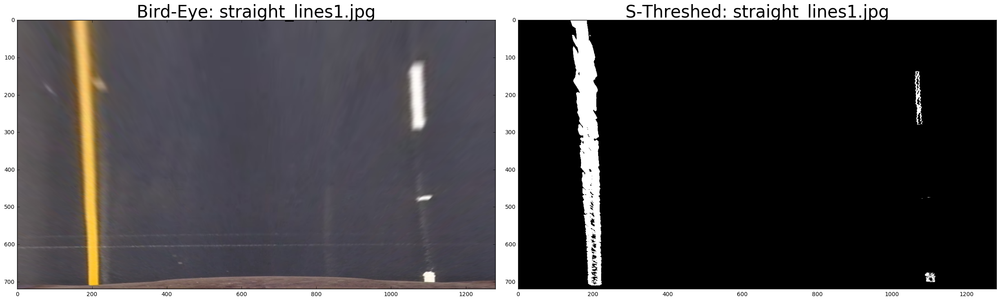

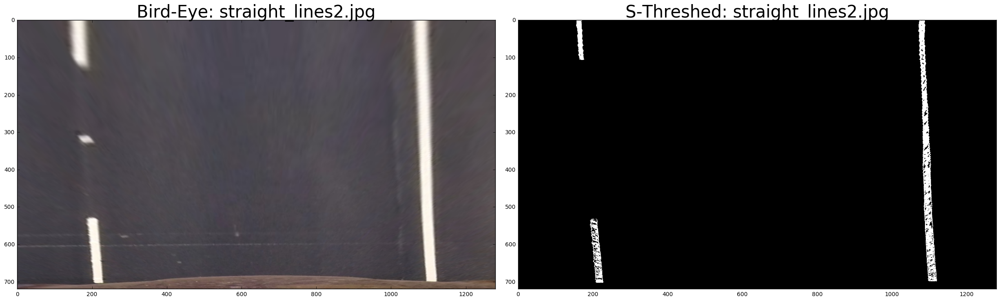

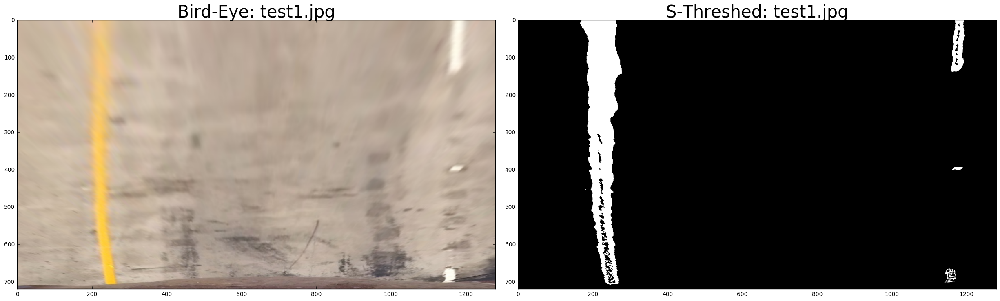

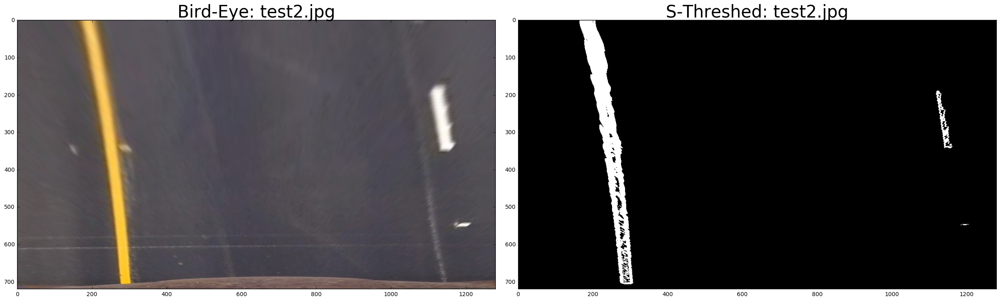

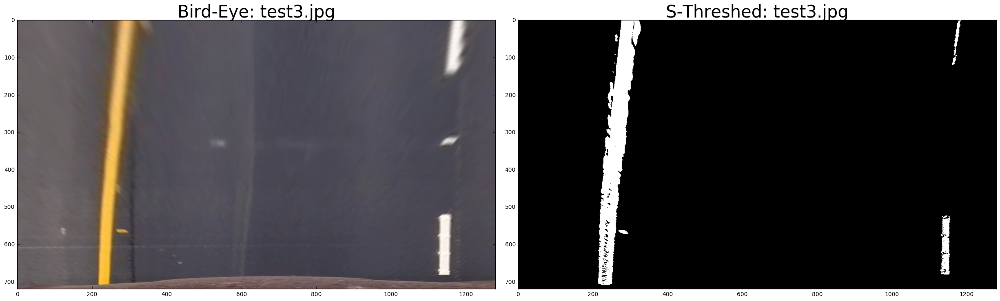

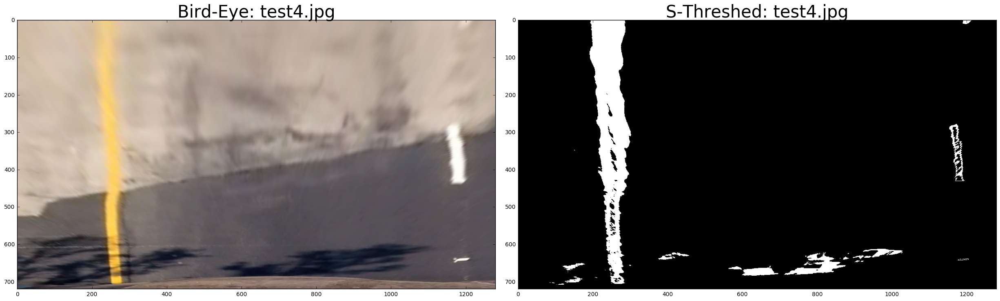

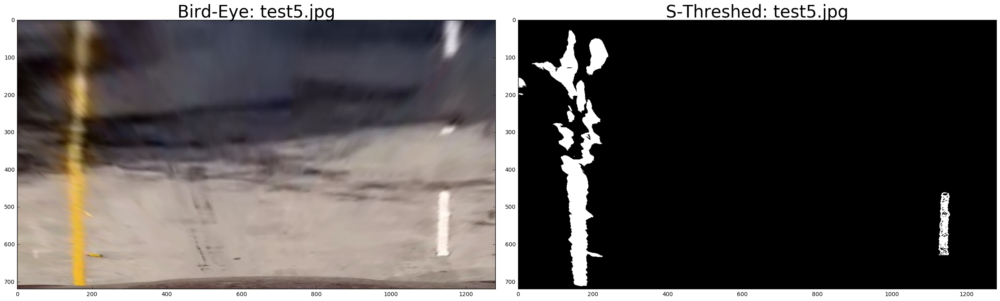

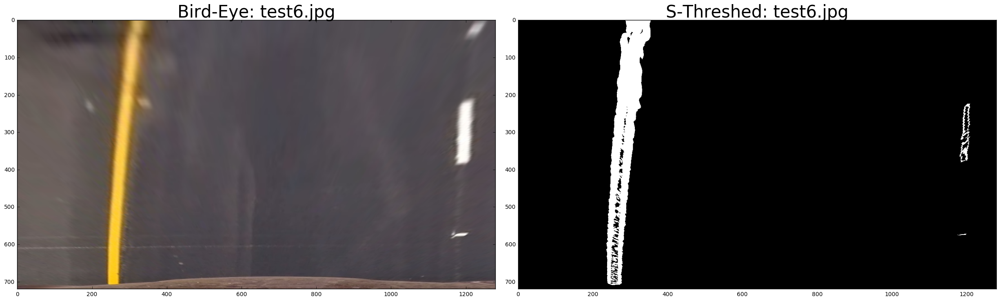

In [10]:
# Step through the test images with birdeye images generated, plot them side-by-side
# to assess the `correct` setting of our PerspectiveTransform (given selected points).
for i in range(timgNum):
    img = tImage[i]
    s_img = s_select(img, thresh=(100, 255))

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Bird-Eye: ' + timages[i][12:], fontsize=30)
    ax2.imshow(s_img, cmap='gray')
    ax2.set_title('S-Threshed: ' + timages[i][12:], fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


### 4.3 Sobel-x Gradient (suitable to lane line direction) threshing

In [11]:
# Define a function that thresholds the Sobel derivative in X
#
# Input:    img - bird-eye view image
#        thresh - Sobel-x gradient threshold
#
def sx_select(img, thresh=(0, 255)):
    # Convert RGB to GRAY
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Sobel x,  take the derivative in x using default kernel size 3
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    # Absolute x derivative to accentuate lines away from horizontal
    abs_sobelx = np.absolute(sobelx)
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    # Return a binary image of thresholded Sobel x
    return sxbinary



### 4.4 Plot Sobel-x Gradient Threshed images (`Bird-Eye` and `Sobel-x threshed` side-by-side)

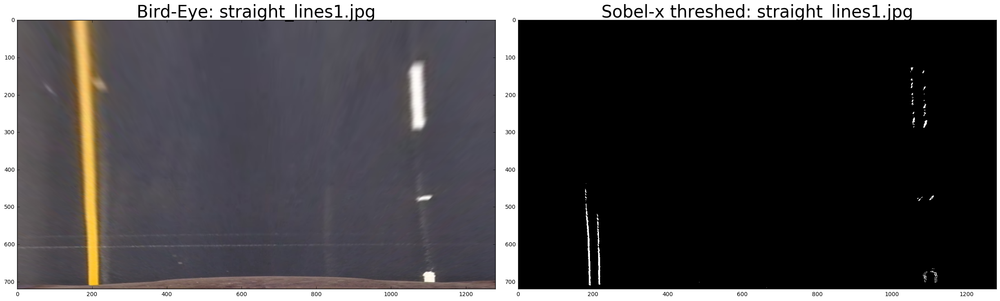

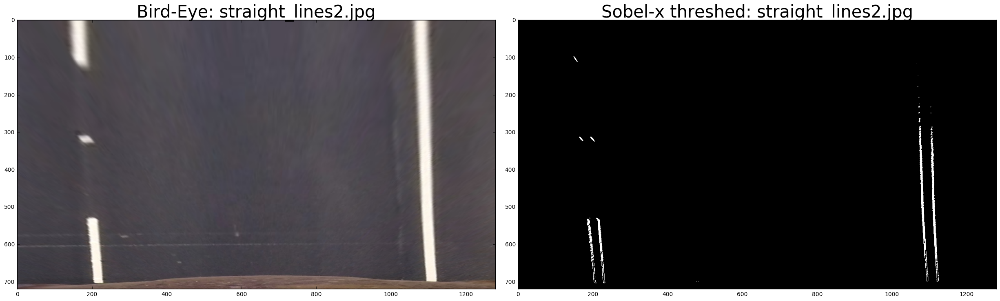

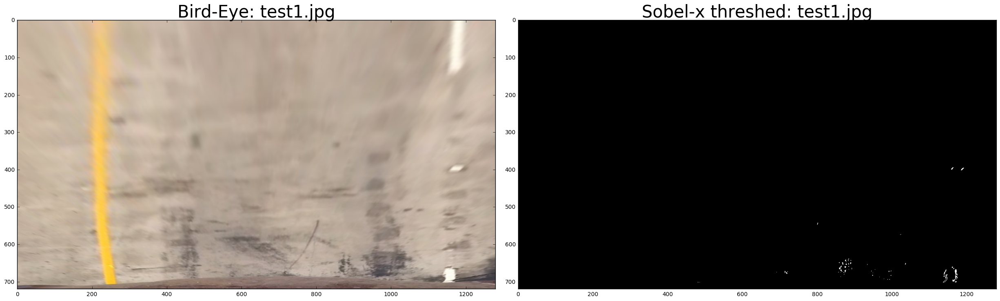

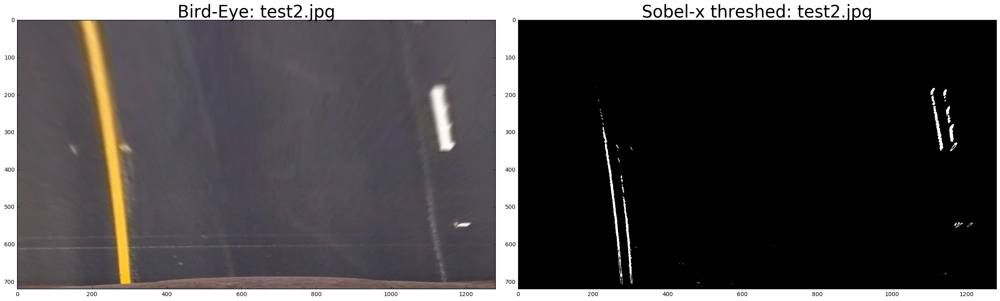

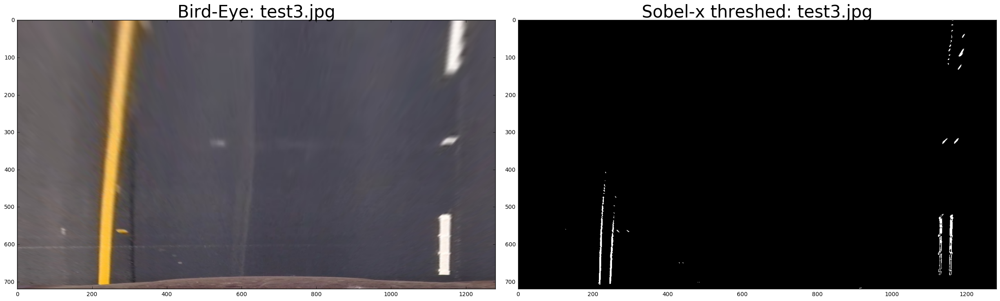

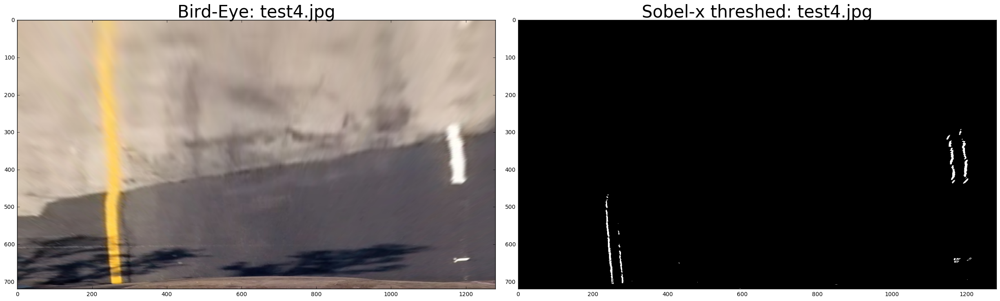

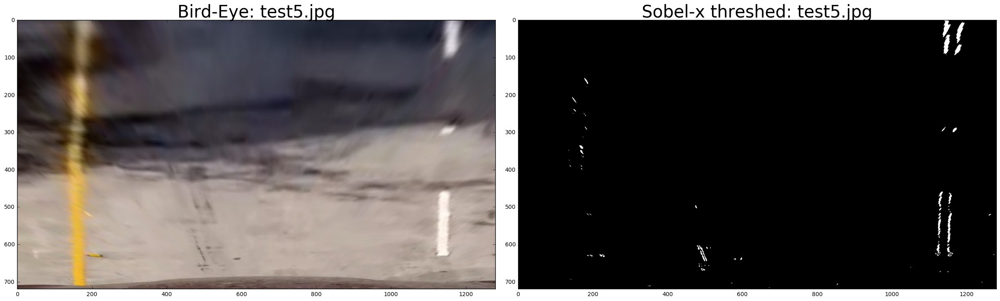

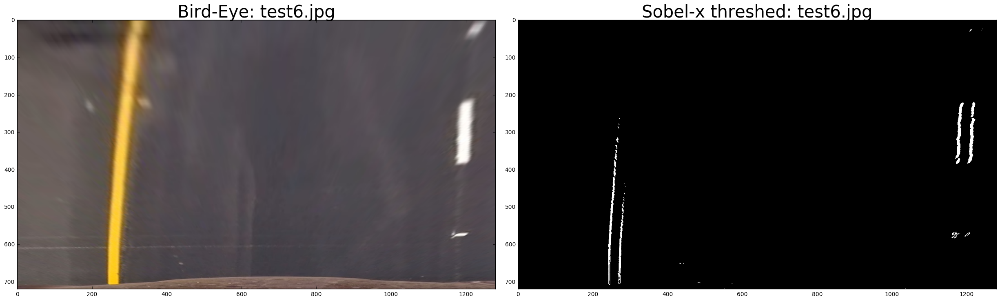

In [12]:

# Step through the test images with birdeye images generated, plot them side-by-side
# to assess the `correct` setting of our PerspectiveTransform (given selected points).
for i in range(timgNum):
    img = tImage[i]
    s_img = sx_select(img, thresh=(70, 160))

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Bird-Eye: ' + timages[i][12:], fontsize=30)
    ax2.imshow(s_img, cmap='gray')
    ax2.set_title('Sobel-x threshed: ' + timages[i][12:], fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


### 4.5 Combined `Color Space S-Channel` and `Sobel-x Gradient` Threshing Filter

In [13]:
# Input:      img - bird-eye view image
#        s_thresh - S-channel threshold
#       sx_thresh - Sobel-x gradient threshold
#
# Return:  Filtered bird-eye view image
#
def combined_filter(img, s_thresh=(0, 255), sx_thresh=(0, 255)):
    s_binary = s_select(img, s_thresh)
    sxbinary = sx_select(img, sx_thresh)
    
    combined = np.zeros_like(sxbinary)
    combined[(s_binary == 1) | (sxbinary == 1)] = 1
    
    return combined


### 4.6 Plot `Color and Gradient` Transformed Binary Images (`Bird-Eye` and `Filtered` side-by-side)

### Combined filter threshed binary images saved as: `output_images/*-bin.jpg`


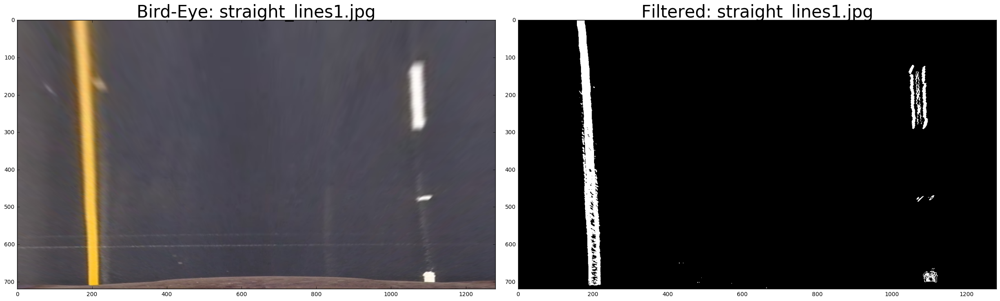

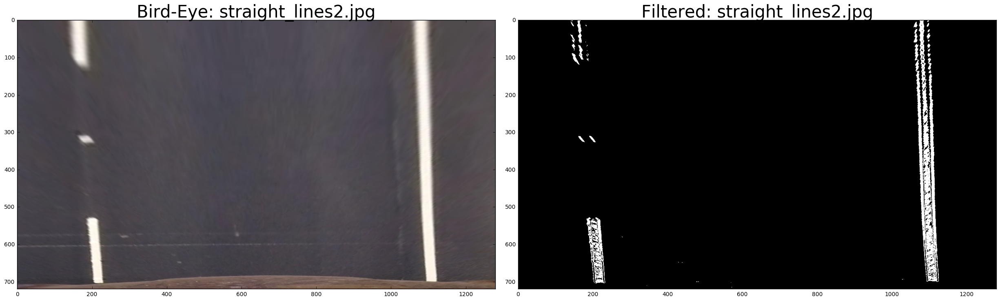

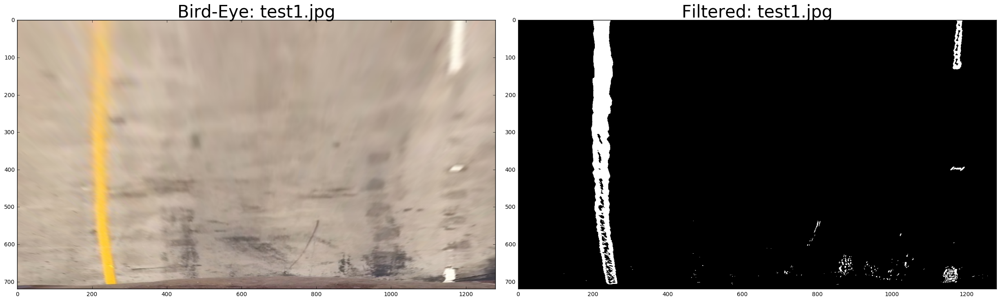

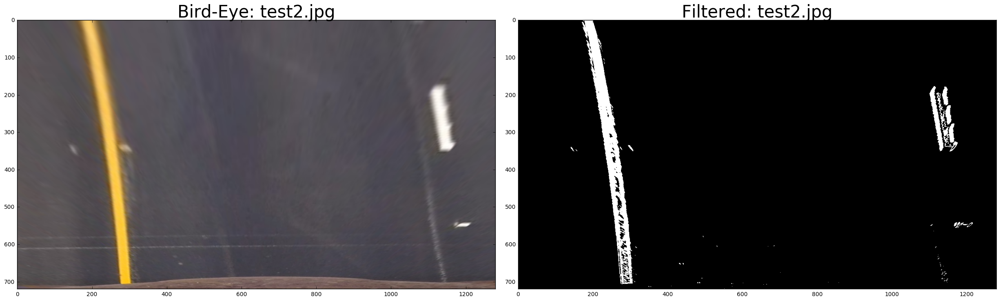

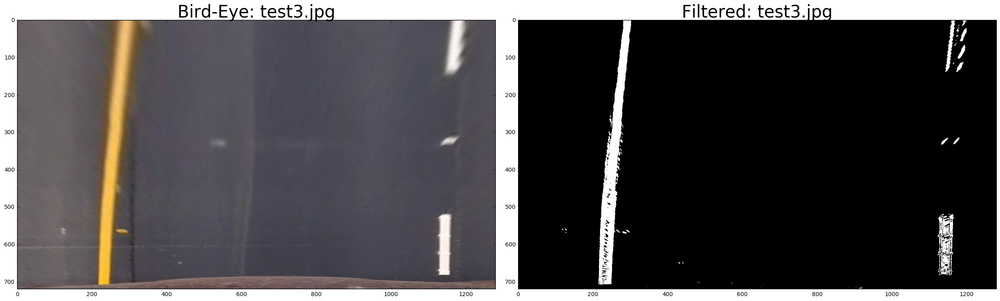

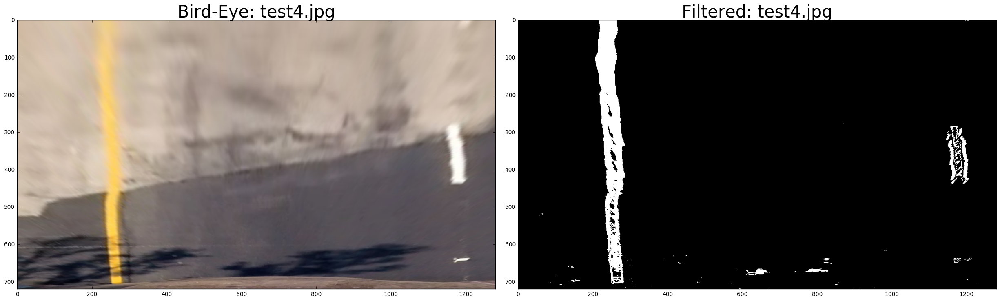

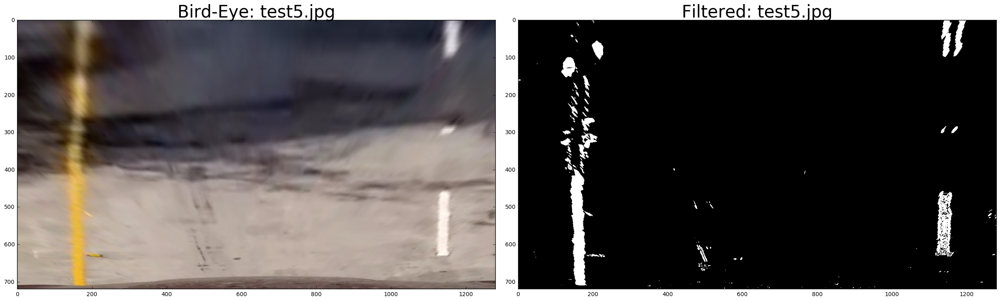

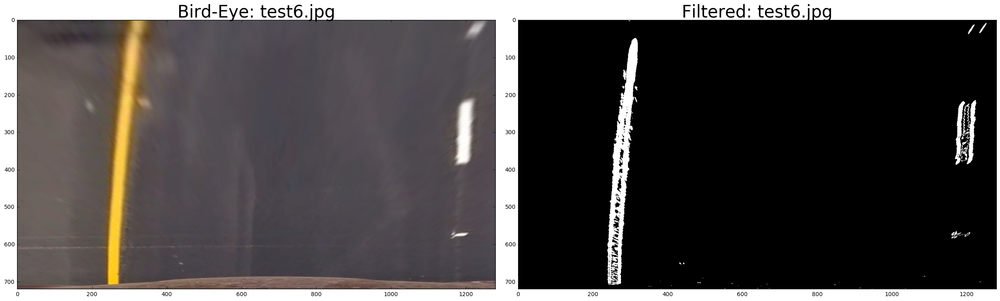

In [14]:
# Step through the test images with birdeye images generated, plot them side-by-side
# to assess the `correct` setting of our PerspectiveTransform (given selected points).
for id in range(timgNum):
    fImage[id] = combined_filter(tImage[id], s_thresh=(150, 255), sx_thresh=(50, 150))

    # output final binary image (to lane line finding) 
    outfile = outputpath + timages[id][12:].split('.')[0] + '-bin.jpg'
    pimg.imsave(outfile, ~fImage[id], cmap='Greys')
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(tImage[id])
    ax1.set_title('Bird-Eye: ' + timages[id][12:], fontsize=30)
    ax2.imshow(fImage[id], cmap='gray')
    ax2.set_title('Filtered: ' + timages[id][12:], fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


## 5. Lane Lines Detection



### 5.1 Visualize `histogram` (on final `filtered binary` images) for demonstration and observation

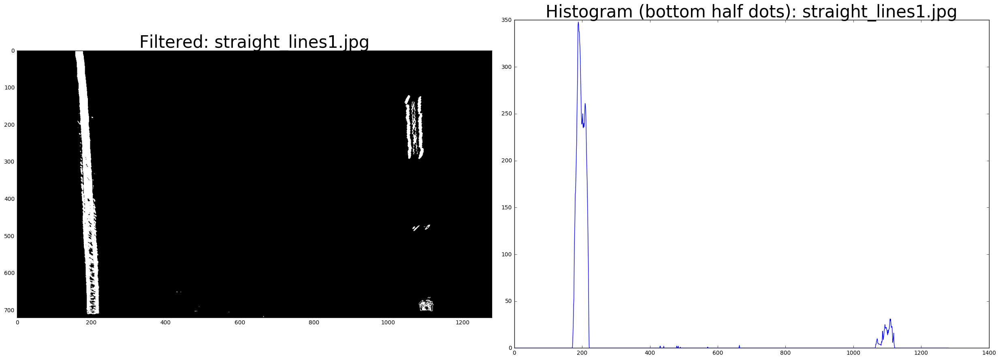

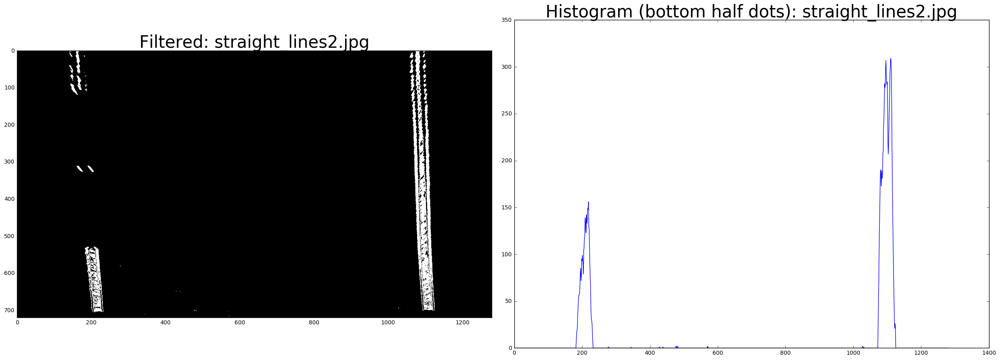

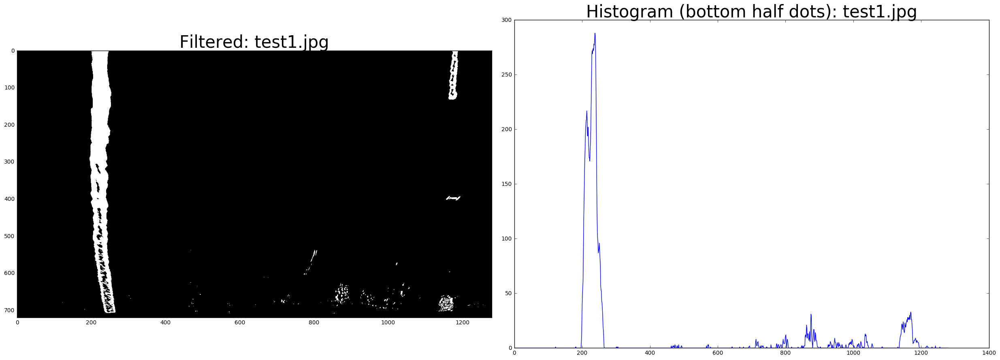

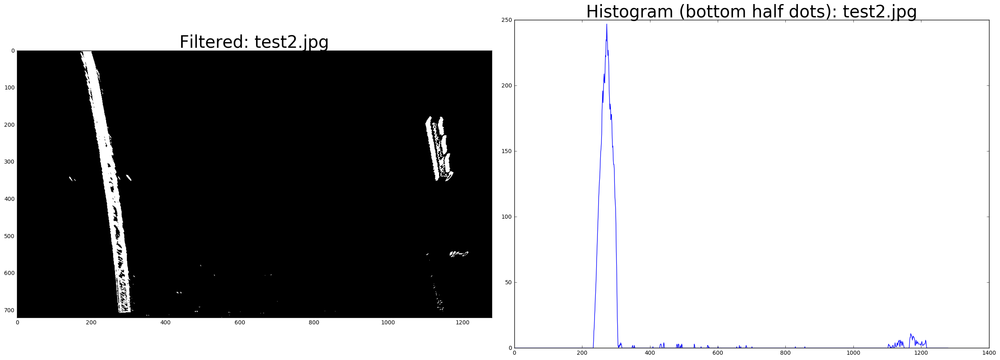

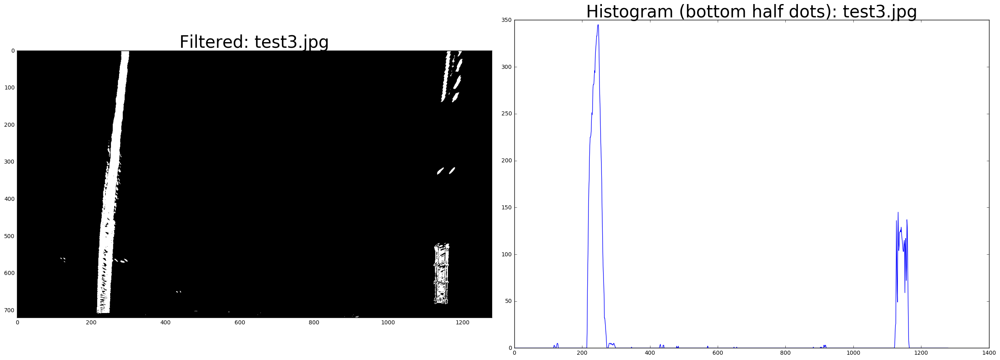

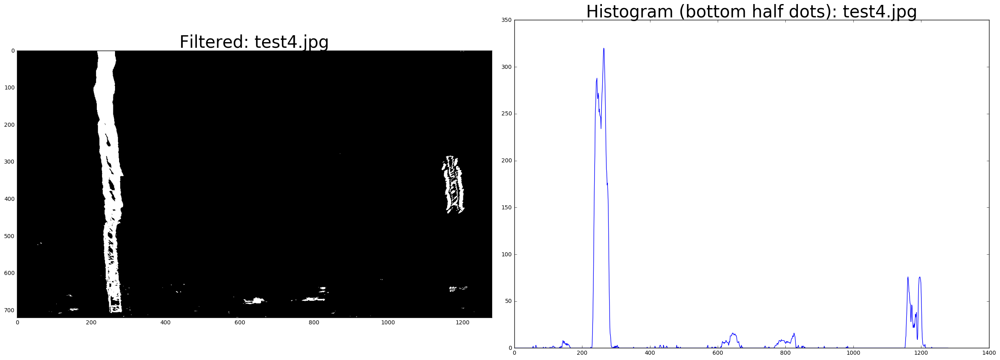

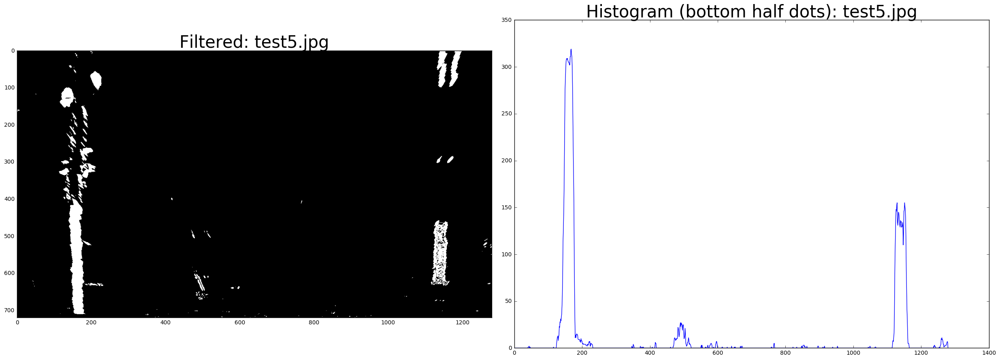

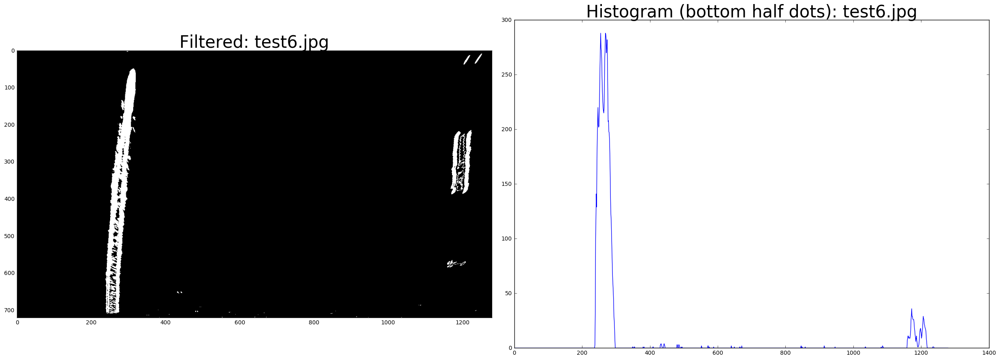

In [15]:
# Step through the test images with birdeye images generated, plot them side-by-side
# to assess the `correct` setting of our PerspectiveTransform (given selected points).
for id in range(timgNum):
    img = fImage[id]
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img, cmap='gray')
    ax1.set_title('Filtered: ' + timages[id][12:], fontsize=30)
    #ax2.imshow(histogram)
    ax2.plot(histogram)
    ax2.set_title('Histogram (bottom half dots): ' + timages[id][12:], fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


### 5.2 Key Observation and Lane Detection Strategies:

   + Two (Left/Right) spiking areas are captures most of time, matching filtered birdeye view with high confidence
   + Dual spikes aren't symmetric, almost not even close to bimodal; spike on either side is not normal distribution, better to use median X of top N points
   + In following implementation, I use the median of top 10 frequent x-coordinates (statistic center) on both side as the `X base` for `Left` and `Right` lines
   + Noise in middle area is mostly negligible with just a few exceptions; Ideal algorithm should mask off certain central area (e.g. filter center lanemark)
   + Following implementation masked off center area [640-100, 640+100] to cancel noise, it's simple but effective (room to improve, e.g. use lane center)
   + An ideal algorithm should prepare for missing spikes on either side (L,R or both), as a robustness enhancement


### 5.3 X-base Detection, Sliding Window and Lane Line Finding `methods`

In [16]:
# This function returns statistic center of X to both Left and Right Lanes per Image/Frame
# Input:
#       img - filtered birdeye view image (binary)
# minheight - minimum threshhold (max frequency of X to xbases) to assert valid detection
# Return:
#       xbase_l - X base for L lane, 0 if undetected
#       xbase_r - X base for R lane, 0 if undetected
#
# N.B.  Consumer (pipeline code) to check return & use historical tracked value if needed
#       historical tracked values should be stored in global Lane tracking class Laneline
def frame_xbases(img, minheight=0):
    # image center in x-axis (Improvement TODO: use lane center in the future)
    xmidpoint = img.shape[1]//2
    
    # Generate histogram along X-axis
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    
    # This is most likely the starting reference point of Left Lane line (X), at bottom
    
    # center offset for post histogram process, exclude center [-100, 100] region to lower noise
    centerOff = 100
    
    # use median vs. mean to derive statistic center (from the top 10 frequent points)
    # of the leftLane base reference point (xbase_l) at ymax
    xbase_l = int(np.median(histogram[:xmidpoint-centerOff].argsort()[-10:][::-1]))
    
    # noise cancellation threshing L lane side
    if histogram[:xmidpoint-centerOff].max() <= minheight:
        xbase_l = 0

    # use median vs. mean to derive statistic center (from the top 10 frequent points)
    # of the rightLane base reference point (xbase_r) at ymax
    xbase_r = int(np.median(histogram[xmidpoint+centerOff:].argsort()[-10:][::-1]))
    xbase_r = xmidpoint + centerOff + xbase_r

    # noise cancellation threshing R lane side
    if histogram[xmidpoint+centerOff:].max() <= minheight:
        xbase_r = 0
    
    return (xbase_l, xbase_r)


# Adaptive sliding window algorithm, and numpy efficient!
# Input Parameters:
#    img: input gray (2d), e.g. shape =  (Y_max=720, X_max=1280)
#  xroot: x base coordinate, initially its histogram epic center
# xdelte: + and - range on x in pixels
#  ybase: y base coordinate, initially its 
# ydelta: +  or - range on y in pixels, according to dir
#  dir=0: mask window from below to above (y-- direction)
#         sliding_win: [ (xroot - xdelta, ybase),
#                        (xroot + xdelta, ybase),
#                        (xroot + xdelta, ybase - ydelta),
#                        (xroot - xdelta, ybase - ydelta) ]
#  dir=1: mask window from above to below (y++ direction)
#         sliding_win: [ (xroot - xdelta, ybase),
#                        (xroot + xdelta, ybase),
#                        (xroot + xdelta, ybase + ydelta),
#                        (xroot - xdelta, ybase + ydelta) ]
# Return:
#   wins: output image, same shape as img,
#         with only sliding_win selection.
#   newx: new xroot to next sliding_win()
def sliding_win(img, xroot, ybase, xdelta=50, ydelta=60, dir=0):
    mask = np.zeros_like(img)
    # Note
    mask[ybase-ydelta:ybase, xroot-xdelta:xroot+xdelta] = 1
    wins = img & mask
    hist = np.sum(wins, axis=0)
    newx = np.argmax(hist)
    # N.B. to API consumer:
    #   if newx == 0:
    #      # no valid selection can be made in this sliding_win
    #      # continue iterate to next sliding_win, with:
    #        xroot   = xroot
    #        ybase  -= ydelta
    #        xdelta += 10
    return (wins, newx)


#########################################################################
#
# Input:
#       img - filtered birdeye view image (binary)
#     llane - class Laneline() instance of Left-Lane
#             no lane line tracking (across frames) if passed with 'None'
#     rlane - class Laneline() instance of Right-Lane
#             no lane line tracking (across frames) if passed with 'None'
# minsample - minimum number of samples (e.g. len(leftx) or len(rightx) )
#             for an independent(leftx, lefty) or (rightx, righty) return
#             for example:
#             if len(leftx) <= minsample:
#                leftx will be merged with prior (recent) leftx in llane
#             minsample is only meaningful when llane/rlane is not 'None' 
#     debug - plot Lane Lines found (to be obsolete)
# Return: 2 tuples
#   (leftx,   lefty) - 2 numpy arrays (x, y) of found  Left line points
#   (rightx, righty) - 2 numpy arrays (x, y) of found Right line points
#
#   Each pair of arrays are ready for quadratic polynomial fit, when enough samples exist
#
# N.B.  Consumer (pipeline code) to set llane and rlane class instances for Lane tracking
#       With historical tracking enabled, when valid llane is provided, and if
#       len(leftx) <= minsample, leftx is merged with prior fit ones to smooth
#       Same applies to right lane side
##############################################################################
def findingLine(img, llane=None, rlane=None, minsample=0, debug=False):
    # leftLines, rightlines are merging binary image buf cross sliding windows
    leftLines  = np.zeros_like(img)
    rightLines = np.zeros_like(img)

    # Just use minsample as minheight, to be fine tuned
    left, right = frame_xbases(img, minheight=minsample)
    
    # When Left lane tracking class instance is provided
    if llane:
        # When current xbase of Left lane line extraction fail
        if left == 0:
            # Ok just do simplest tracking / estimation first:
            # track moving average is xbase does NOT seem good
            # better model could use vehicle shifting direction
            # between Lanes, to do that we would need:
            # - theta: angle delta between vehicle heading direction
            #  (~90 degree) & tangent angle of prior polyfit at ymax 
            # - vehicle speed, and video frame interval in time
            # As YOU SEE it is little complicated, left as TODO
            #
            # CONS of this short term memory approximation:
            # - Can't smooth out multiple consecutive loss of track
            left = llane.xbase_get()
        else:
            # Update 'left' if it is not considered valid!
            if not llane.xbase_valid(left):
                left = llane.xbase_get()

    # Apply the same xbase tracking to right lane line
    if rlane:
        if right == 0:
            right = rlane.xbase_get()
        else:
            # Update 'right' if it is not considered valid!
            if not rlane.xbase_valid(right):
                right = rlane.xbase_get()

    # N.B.
    # xbase coordinates:'left' / 'right' are
    # smooth-ed (noise rejected) from now on
    
    ymax = img.shape[0]
    slides = 12
    ydelta = ymax//slides

    ybase = ymax
    
    # winSize is the half size of slide windown length on X-axis in searching
    #            qualified points around X-center: as xdelta to sliding_win()
    winSize = 50
    
    # win_inc is the incremental to winSize each time no point is searched in
    # sliding window; idea is to increase X-span in next sliding search since
    # it uses last X-center (previous xbase) but an updated ybase
    win_inc = 10

    # initial search band width = 100: [xbase - xdelta, xbase + xdelta]
    xdelta = winSize

    # produce Left Lane Line Points to np.polyfit
    for i in range(slides):
        win, nx = sliding_win(img, left, ybase, xdelta)
        # ybase step up by 60
        ybase -= ydelta
        if nx == 0:
            # if no point is found for this line in this sliding window iteration
            # increase horizontal searching band width for next strip/sliding_win
            xdelta += win_inc
            continue
        else:
            left = nx
            # reset searching width to default +/- 50
            xdelta = winSize
            leftLines |= win

    ybase = ymax
    xdelta = winSize
    # produce Right Lane Line Points to np.polyfit
    for i in range(slides):
        win, nx = sliding_win(img, right, ybase, xdelta)
        # ybase step up by 60
        ybase -= ydelta
        if nx == 0:
            # if no point is found for this line in this sliding window iteration
            # increase horizontal searching band width for next strip/sliding_win
            xdelta += win_inc
            continue
        else:
            right = nx
            # reset searching width to default +/- 50
            xdelta = winSize
            rightLines |= win
            
    # This to be obsolete
    if debug:
        lines = np.zeros_like(leftLines)
        lines |= leftLines
        lines |= rightLines
        plt.imshow(lines, cmap='gray')

    # Now build up (X, Y) np.arrays from numpy 2-D array leftLines and rightLines
    leftx, lefty = np.nonzero(leftLines)
    
    # Lane line tracking for left lane
    if llane:
        if len(leftx) <= minsample:
            # make sure we have enough samples for fit
            leftx = np.concatenate((leftx, llane.lastx))
            lefty = np.concatenate((lefty, llane.lasty))
        else:
            # update line cache with current samples
            llane.lastx = leftx
            llane.lasty = lefty

            
    rightx, righty = np.nonzero(rightLines)

    # Lane line tracking for right lane
    if rlane:
        if len(rightx) <= minsample:
            rightx = np.concatenate((rightx, rlane.lastx))
            righty = np.concatenate((righty, rlane.lasty))
        else:
            rlane.lastx = rightx
            rlane.lasty = righty

    return ((leftx, lefty), (rightx, righty))


##############################################################
#
# Curvature Radius and Vehicle Offset wrt. Center of the Lane
#
# Input: to be fitted Left and Right Lane line points finding
#
# Return: (curvature, centeroffs)
#         - curvature in meter
#         - centeroffs in centimeter,
#           positive: vehicle is right to the lane center
#           negative: vehicle is left  to the lane center
# N.B.
#      return one curvature radius average from L and R lines
#
##############################################################
def curvature_centeroffs(leftx, lefty, rightx, righty):
    left_fit_cr  = np.polyfit( lefty*ym_per_pix, leftx*xm_per_pix, 2 )
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)


    # y_eval = 720, positioned at bottom horizontal line
    
    left_curverad =  ((1 + (2*left_fit_cr[0]*y_eval + left_fit_cr[1])**2)**1.5) \
                         / np.absolute(2*left_fit_cr[0])

    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval + right_fit_cr[1])**2)**1.5) \
                         / np.absolute(2*right_fit_cr[0])

    # Average curature to yield in-parallel Left/Right Lane Line curves :)
    curverad = (left_curverad + right_curverad) / 2

    lane_xleft = left_fit_cr[0]*(y_eval*ym_per_pix)**2 + left_fit_cr[1]*(y_eval*ym_per_pix) + left_fit_cr[2]
    lane_xright = right_fit_cr[0]*(y_eval*ym_per_pix)**2 + right_fit_cr[1]*(y_eval*ym_per_pix) + right_fit_cr[2]

    lane_center = (lane_xleft + lane_xright) / 2
    
    # w = 1280
    vehicle_center = (w * xm_per_pix) / 2
    
    centeroffs = (vehicle_center - lane_center)*100
        
    return (curverad, centeroffs)


##############################################################
#
# Color warp found Lane lines back to original undistort image
#
# Input:
#
#   undistort - undistorted image from original camera's space
#       leftx - X coordinates of to be fitted Left line points
#       lefty - Y coordinates of to be fitted Left line points
#      rightx - X coordinates of to be fitted Right line point
#      righty - Y coordinates of to be fitted Right line point
#       llane - class Laneline() instance of tracked Left Lane
#               pass with 'None' or ignore if no line tracking
#       rlane - class Laneline() instance of tracked RightLane
#               pass with 'None' or ignore if no line tracking
#
# Return:
#           Color warped image with Lane lines section merged
#
##############################################################
def colorwarp(undistort, leftx, lefty, rightx, righty, llane = None, rlane = None):
    # Quadratic fit coefficients
    l_fit = np.polyfit(lefty, leftx, 2)

    # when 'Left' lane line tracked
    if llane:
        # GET 'l_fit' from cache instead if it is considered invalid
        if not llane.fit_valid(l_fit):
            l_fit = llane.fit_get()
    
    r_fit = np.polyfit(righty, rightx, 2)

    # when 'Right' lane linetracked
    if rlane:
        # GET 'r_fit' from cache instead if it is considered invalid
        if not rlane.fit_valid(r_fit):
            r_fit = rlane.fit_get()

    # N.B. From now on:
    # Fitted Lane lines (L/R) are considered smooth (noise rejected)!
            
    balance_lr = False
    if balance_lr:
        #
        #N.B. I found it less appealing to balance L/R curvature in video
        #     due to independent update to Left and Right line (instance)
        #     In other words - async Left and Right line smooth may cause
        #     balancing not effective, SO it is disabled in this function!
        #
        # This average on high order polynomial coefficients is important
        # Implemented to yield in-parallel Left/Right Lane Line curves :)
        l_fit[0] = (l_fit[0] + r_fit[0])/2
        r_fit[0] = l_fit[0]
        l_fit[1] = (l_fit[1] + r_fit[1])/2
        r_fit[1] = l_fit[1]

    # Generate Lane line points to both Left and Right
    # yvals = np.arange(720)
    l_fitx = l_fit[0]*yvals**2 + l_fit[1]*yvals + l_fit[2]
    r_fitx = r_fit[0]*yvals**2 + r_fit[1]*yvals + r_fit[2]

    # Calculate Lane lines Curvature Radius and Center Departure
    rad, dev = curvature_centeroffs(leftx, lefty, rightx, righty)

    # (h, w) = (720, 1280)
    warp_zero = np.zeros((h, w), np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the fitted x and y points into usable format for cv2.fillPoly()
    pts_l = np.array([np.transpose(np.vstack([l_fitx, yvals]))])
    pts_r = np.array([np.flipud(np.transpose(np.vstack([r_fitx, yvals])))])
    pts = np.hstack((pts_l, pts_r))

    # Draw the lane onto the warped blank image in GREEN
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    # Warp the birdeye view color_warp back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (warp_zero.shape[1], warp_zero.shape[0])) 

    # Combine the newwarp with the previous undistrorted image
    result = cv2.addWeighted(undistort, 1, newwarp, 0.3, 0)
    # And add text annotations
    cv2.putText(result,"Curvature Radius: " + "{0:.2f}".format(rad) + " (m)", (60,60), \
                cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    cv2.putText(result,"Center Departure: " + "{0:.2f}".format(dev) + " (cm)", (60,100), \
                cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

    return result


### 5.4 Plot Lane Line Fitted Images (`Filtered Binary` and `Fitted Lane Lines` side-by-side)


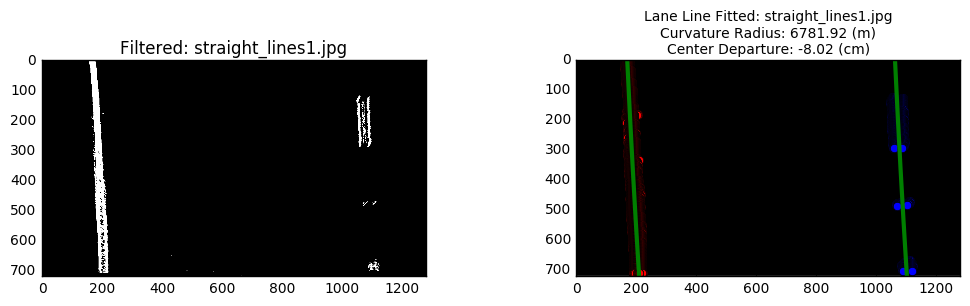

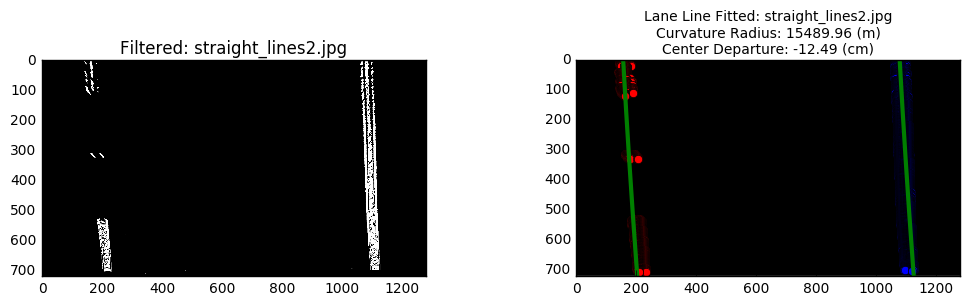

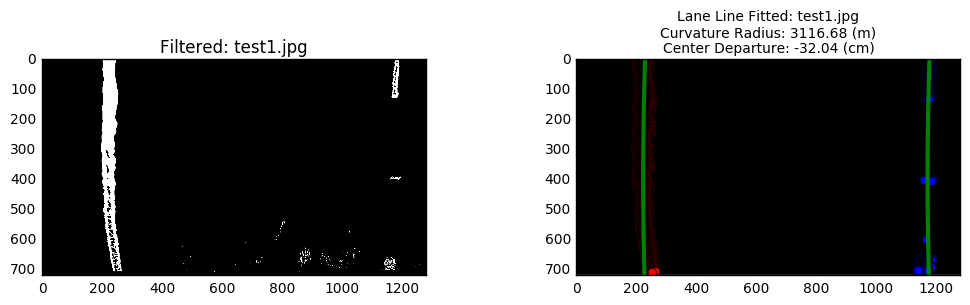

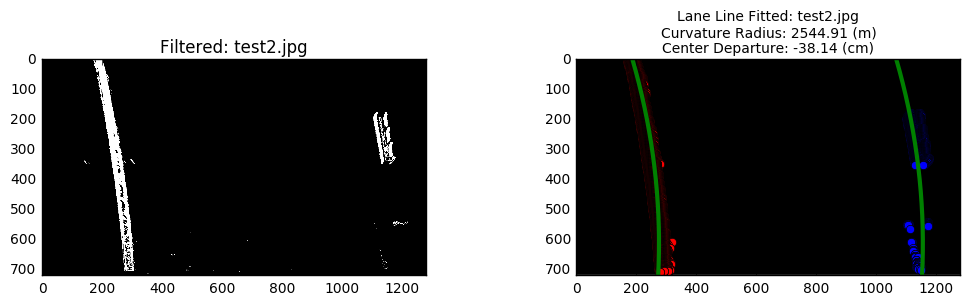

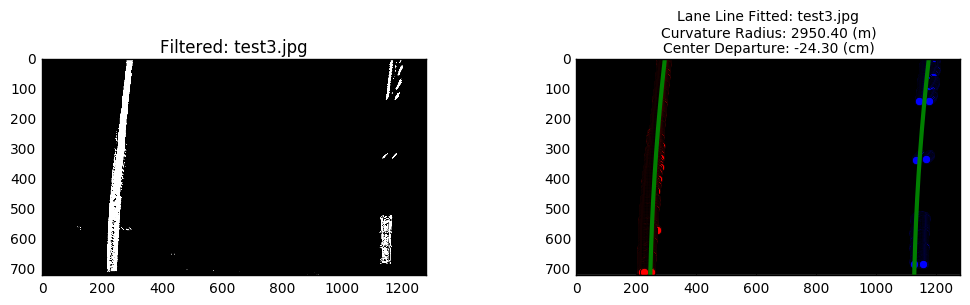

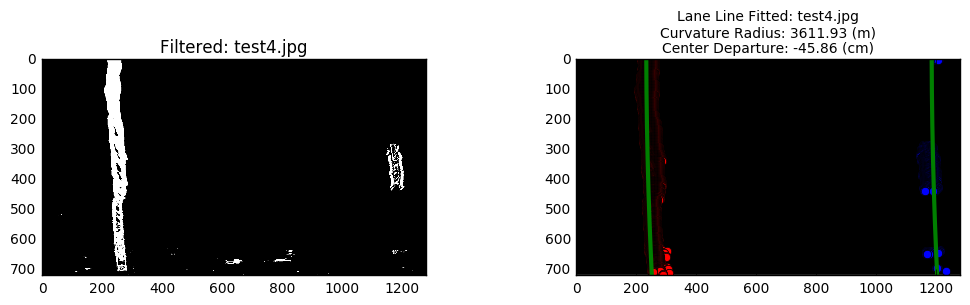

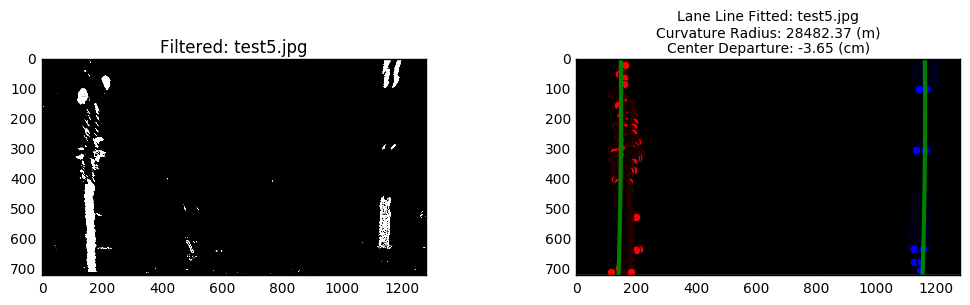

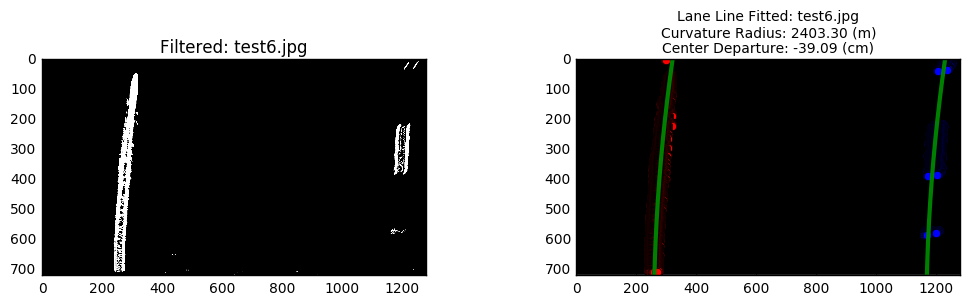

In [17]:
# Step through the test images with birdeye images generated, plot them side-by-side
# to assess the `correct` setting of our PerspectiveTransform (given selected points).
for id in range(timgNum):
    img = fImage[id]
    
    (yl, xl), (yr, xr) = findingLine(img, debug=False)

    left_fit = np.polyfit(yl, xl, 2)
    right_fit = np.polyfit(yr, xr, 2)

    # This average on high order polynomial coefficients is important
    # to yield in parallel Left/Right Lane Line curves :)
    left_fit[0] = (left_fit[0] + right_fit[0])/2
    right_fit[0] = left_fit[0]
    left_fit[1] = (left_fit[1] + right_fit[1])/2
    right_fit[1] = left_fit[1]

    # yvals = np.arange(720)
    tl_fitx[id] = left_fit[0]*yvals**2 + left_fit[1]*yvals + left_fit[2]
    tr_fitx[id] = right_fit[0]*yvals**2 + right_fit[1]*yvals + right_fit[2]

    # Calculate Lane lines Curvature Radius and Center Departure
    rad[id], dev[id] = curvature_centeroffs(xl, yl, xr, yr)

    # Plotting
    plt.figure(figsize=(5.0 * 2, 2.4 * 1))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.title('Filtered: ' + timages[id][12:], size=12)

    plt.subplot(1, 2, 2)
    lines = np.zeros_like(img)
    plt.imshow(lines, cmap='gray')
    plt.plot(xl, yl, 'o', color='red')
    plt.plot(xr, yr, 'o', color='blue')
    plt.xlim(0, 1280)
    plt.ylim(0, 720)
    plt.plot(tl_fitx[id], yvals, color='green', linewidth=3)
    plt.plot(tr_fitx[id], yvals, color='green', linewidth=3)
    plt.gca().invert_yaxis() # to visualize as we do the images
    plt.title('Lane Line Fitted: '+timages[id][12:]+'\nCurvature Radius: '+"{0:.2f}".format(rad[id])+' (m)' \
                                                   +'\nCenter Departure: '+"{0:.2f}".format(dev[id])+' (cm)', size=10)


### 5.5 Plot Final `Warped` Images (`Undistorted` and `Final Warped` side-by-side)
###       Final `Warped` images saved as `output_images/*-warp.jpg`


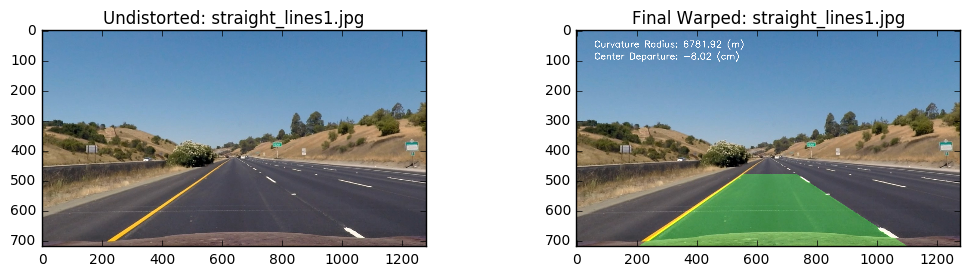

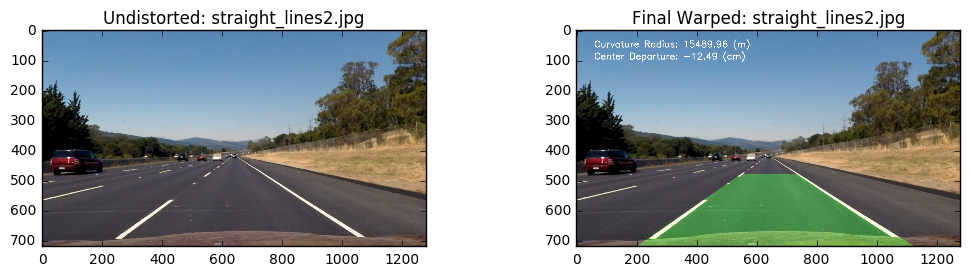

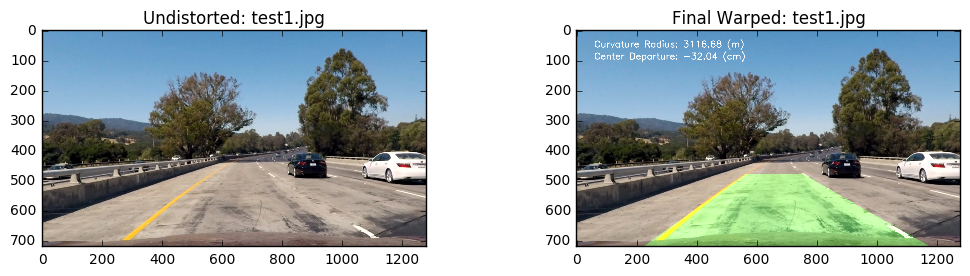

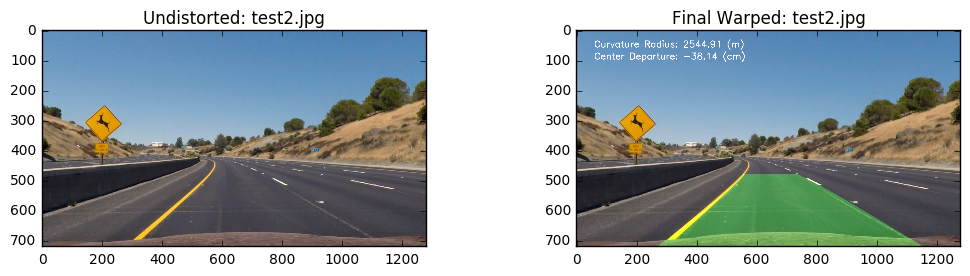

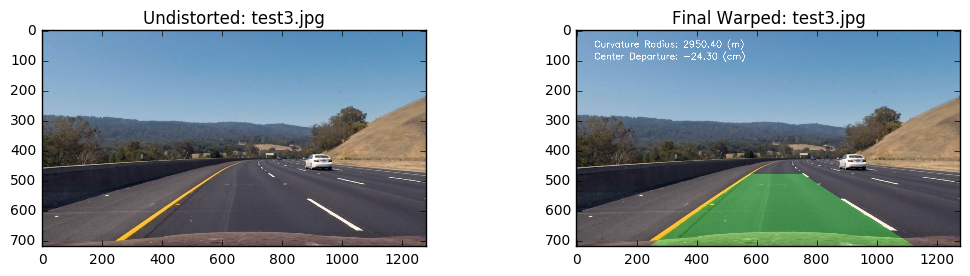

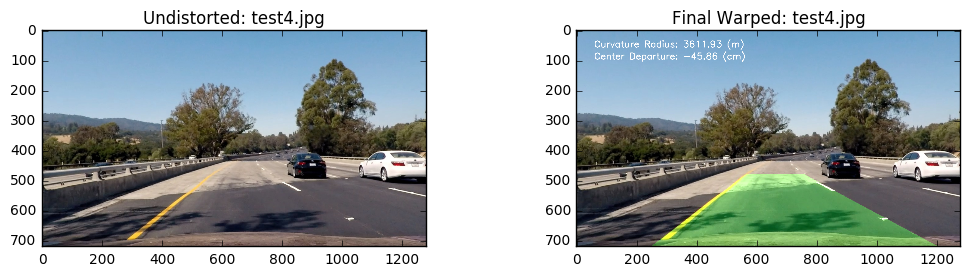

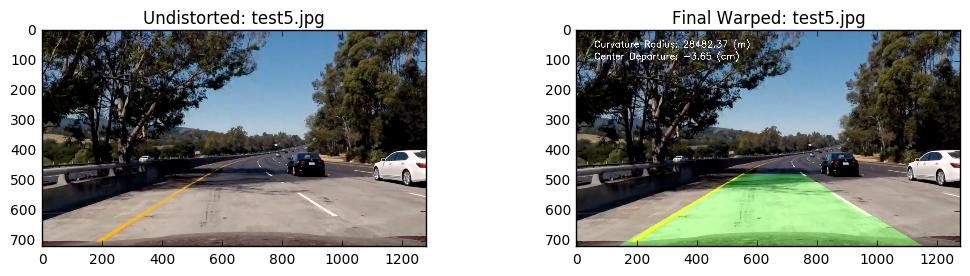

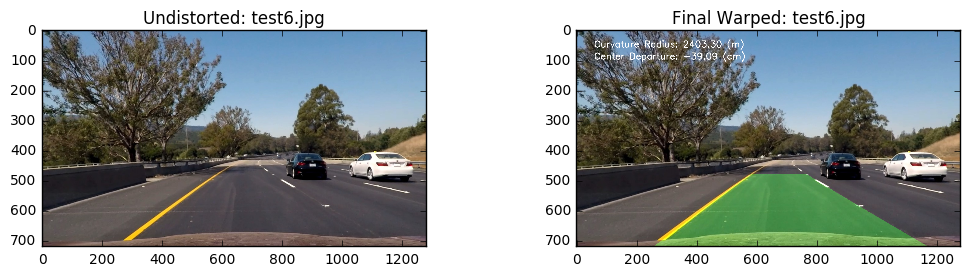

In [18]:
# Step through the test images with birdeye images generated, plot them side-by-side
# to assess the `correct` setting of our PerspectiveTransform (given selected points).
#
# N.B.
#     We could use defined API: colorwarp() to generate final warped image, but that
#     requires refit, since we already have fitted lane lines from prior steps, so I
#     just used a little boilerplate code here in demonstrating final warped images.
#
#     Image pipeline: Use colorwarp() instead!
#
for id in range(timgNum):
    
    # output color warped image
    outfile = outputpath + timages[id][12:].split('.')[0] + '-warp.jpg'

    # (h, w) = (720, 1280)
    warp_zero = np.zeros((h, w), np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the fitted x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([tl_fitx[id], yvals]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([tr_fitx[id], yvals])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image in GREEN
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    # Warp the birdeye view color_warp back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (warp_zero.shape[1], warp_zero.shape[0])) 

    # Combine the newwarp with the previous undistrorted image
    result = cv2.addWeighted(uImage[id], 1, newwarp, 0.3, 0)
    cv2.putText(result,"Curvature Radius: " + "{0:.2f}".format(rad[id]) + " (m)", (60,60), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    cv2.putText(result,"Center Departure: " + "{0:.2f}".format(dev[id]) + " (cm)", (60,100), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    cv2.imwrite(outfile, cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    
    # Plotting
    plt.figure(figsize=(5.0 * 2, 2.4 * 1))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    plt.subplot(1, 2, 1)
    plt.imshow(uImage[id])
    #plt.imshow(img, cmap='gray')
    plt.title('Undistorted: ' + timages[id][12:], size=12)

    plt.subplot(1, 2, 2)
    plt.imshow(result)
    plt.title('Final Warped: ' + timages[id][12:], size=12)


## 6. Project Video (Pipeline)

### 6.1 Image Pipeline

+ <b>N.B.</b>
    - Used Quadratic (^2) Polynomial polyfit to fit the curve Lane Lines
    - Curvature is averaged between Left and Right lane lines, so just one final result (m) is warped back to video
    - Vehicle Lane Center Departure is derived from image center and lane center, result in centi-meters
    - Left and Right lane lines are tracked & smoothed independently, advanced synthesis still available 

In [19]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image with lines are drawn on lanes)
    #
    # Main Steps:
    # 1.  Undistort each Video frame
    # 2.  Perspective Transforms to BirdEye
    # 3.  Apply Color & Gradient to BirdEye
    # 4.  Sliding Window and Line Detection
    # 4.  Finding Lane lines (with tracking)
    #   4.1  X-base detection (with rejection)
    #   4.2  SlidingWindow to find fitted points
    #   4.3  Lane Lines fitting (with rejection)
    #   4.4  Moving Average (N.B. rejection and
    #        moving average is enabled via lane
    #        line tracking in 2 separate Left &
    #        Right class instances)
    # 5. Warp Lanelines back to Color Undistort

    # Declare global class instance
    global lline, rline
    
    undistort = cv2.undistort(image, mtx, dist, None, mtx)
    
    img = cv2.cvtColor(undistort, cv2.COLOR_BGR2RGB)

    birdeye = cv2.warpPerspective(img, M, imsize, flags=cv2.INTER_LINEAR)
    
    filtered = combined_filter(birdeye, s_thresh=(150, 255), sx_thresh=(50, 150))

    (yl, xl), (yr, xr) = findingLine(filtered, llane = lline, rlane = rline)
    
    warp = colorwarp(undistort, xl, yl, xr, yr, llane = lline, rlane = rline)

    return warp


### 6.2 Load and Process Video

In [20]:
# Play video inline
project_output = 'output_images/project4.mp4'
clip1 = VideoFileClip("project_video.mp4")
lline = Laneline()
rline = Laneline()
project_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video output_images/project4.mp4
[MoviePy] Writing video output_images/project4.mp4


100%|█████████▉| 1260/1261 [03:33<00:00,  6.06it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/project4.mp4 

CPU times: user 13min 26s, sys: 1min 13s, total: 14min 39s
Wall time: 3min 34s


### 6.3 Play Project Video Inline

In [21]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

--------

## 7. Reflection and Discussion

-    ### It sounds logical to do Perspective Transform first then Color and Gradient filtering, provided more focus
     - And that is how I did
     
-    ### Yet to synthesis vehicle `theta` angle (angle between vehicle heading and lane heading) that is computable
     - It is very useful feature to predict vehicle shift, lane center departure, and next lane line starting X-base, etc.
     - It is computable from the angle of tangent at (X-base, Ymax=720) on previous fitted lane lines
     
-    ### Yet to synthesis left & right lines tracking, derive good polyfit coefficient from other if one side is rejected

-    ### Yet to support adaptive (vs. static) region selection for perspective tranformation
     - This is very useful to work with different road conditions, such as shorter viewpoint, windier turns, etc.

-    ### Yet to add better noise cancellation to filter objects inside fillPoly region, since those may fail lane finding
     - Those interferencing objects can be CARs ahead nearby, etc.

-    ### Yet to harness discovered lane line curvatures and lane center departures
     - They can be used to derive steering angles (with other sources, such as DNN trained singnals) for example.
     
-    ### Yet to refector code further to more sophisticated tracking, rejection and smooth
     - Move more data and add more logic inside classes
